In [1]:
import sys, os
import torch
import torch.nn as nn
import numpy as np
from torchvision import transforms
import tqdm
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

In [2]:
from sklearn.metrics import mean_squared_error

In [3]:
sys.path.append("../")

In [4]:
from Transformers import ChannelsFirst, ToTensor, Cut, Rescale, splitter_train_val_test

In [5]:
from DataSets import UNetDatasetFromFolders

In [6]:
from cUNet_pytorch_pooling import cUNet, dice_loss

In [7]:
DATA_DIR_DEEPTHOUGHT="/storage/yw18581/data"
data_dir = DATA_DIR_DEEPTHOUGHT

In [8]:
model_name = "../model/trained_cUNet_pytorch_regression_250epochs_coeff_mask0.75_validation.pkl"

In [9]:
model_inference = cUNet(out_size=1)

In [10]:
model_inference.load_state_dict(torch.load(model_name))

<All keys matched successfully>

In [11]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [12]:
root_folder = os.path.join(data_dir, "dataset")

In [13]:
composed = transforms.Compose([Cut(), Rescale(.25), ChannelsFirst(), ToTensor()])

In [14]:
complete_dataset = UNetDatasetFromFolders(root_folder, transform=composed)

In [15]:
data_loaders, data_lengths = splitter_train_val_test(complete_dataset,
                                                    validation_split=0.2,
                                                    test_split=0.2,
                                                    batch=16,
                                                    workers=4)

In [16]:
data_lengths

{'train': 5717, 'val': 1429, 'test': 1786}

In [17]:
model_inference.eval()
model_inference.to(device)

cUNet(
  (conv_block_down1): Sequential(
    (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (conv_block_down2): Sequential(
    (0): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (conv_block_down3): Sequential(
    (0): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (conv_block_down4): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
  )
  (conv_block_d

In [19]:
data_lengths

{'train': 5717, 'val': 1429, 'test': 1786}

batch 1
1: true_dist: 35, pred_dist: [34.681446]


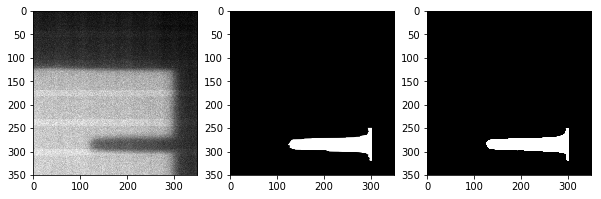

2: true_dist: 3, pred_dist: [2.7890816]


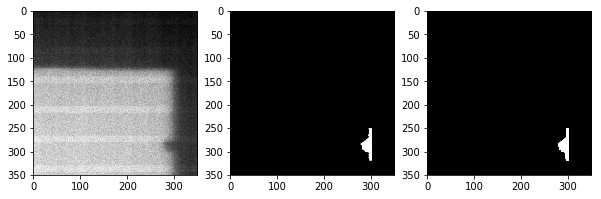

3: true_dist: 4, pred_dist: [3.967529]


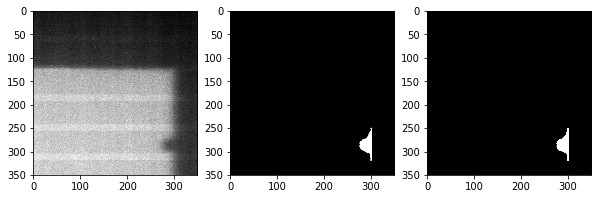

4: true_dist: 15, pred_dist: [14.968759]


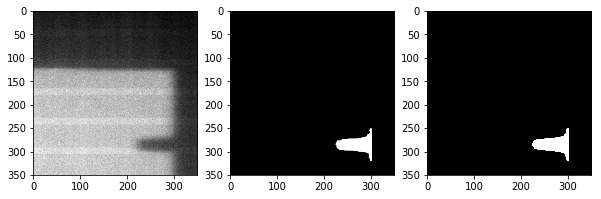

5: true_dist: 4, pred_dist: [3.7550755]


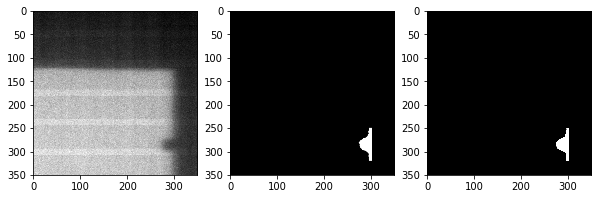

6: true_dist: 15, pred_dist: [14.746319]


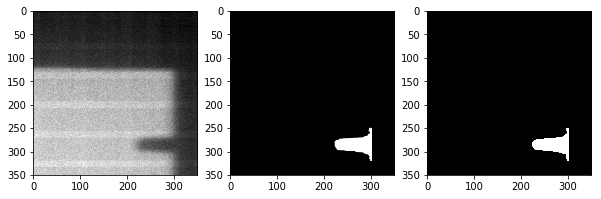

7: true_dist: 2, pred_dist: [1.7551246]


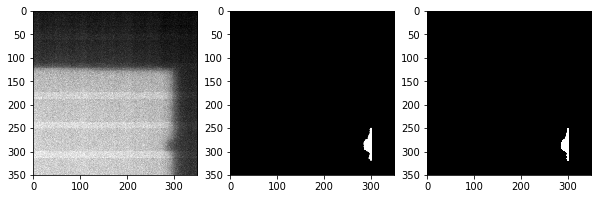

8: true_dist: 3, pred_dist: [2.7781324]


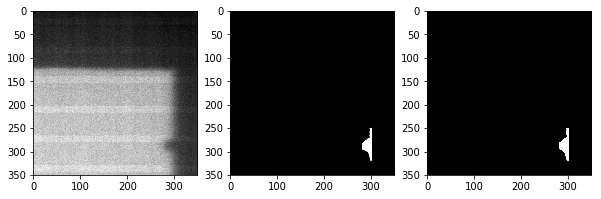

9: true_dist: 1, pred_dist: [0.82337844]


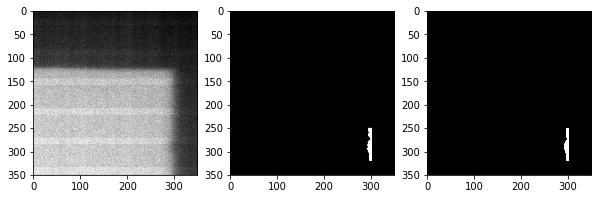

10: true_dist: 2, pred_dist: [1.7933284]


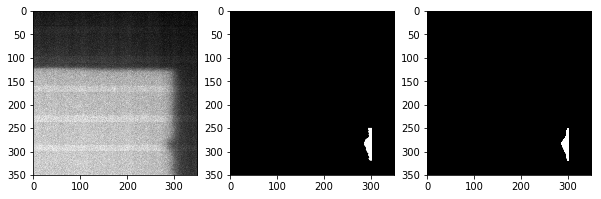

11: true_dist: 25, pred_dist: [24.772146]


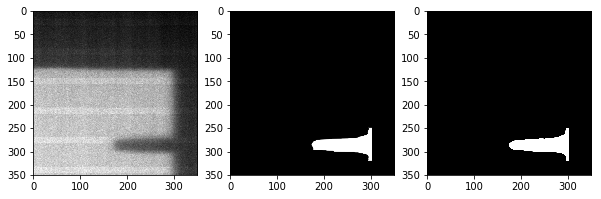

12: true_dist: 2, pred_dist: [1.680878]


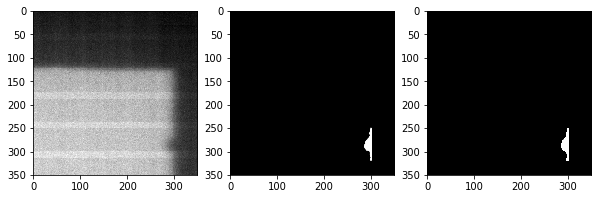

13: true_dist: 20, pred_dist: [19.79963]


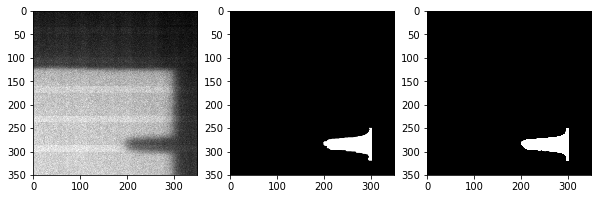

14: true_dist: 3, pred_dist: [2.9866967]


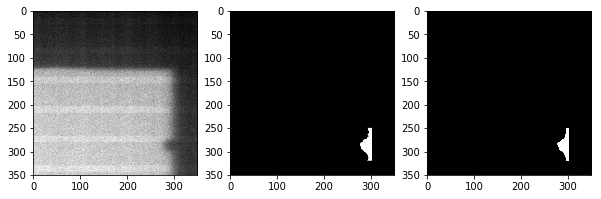

15: true_dist: 20, pred_dist: [19.894123]


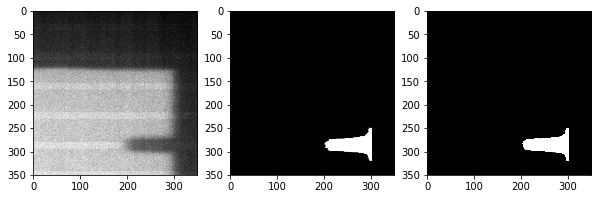

16: true_dist: 25, pred_dist: [24.912895]


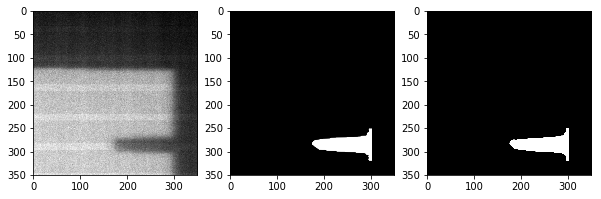

batch 2
1: true_dist: 25, pred_dist: [24.793945]


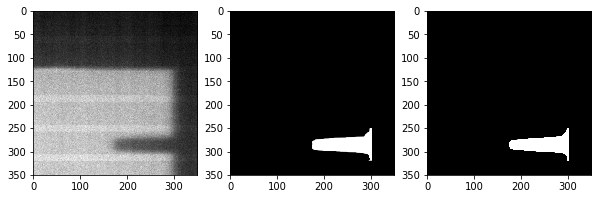

2: true_dist: 25, pred_dist: [24.682796]


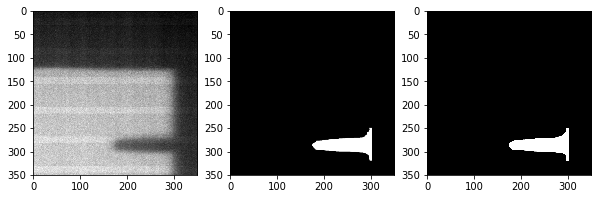

3: true_dist: 1, pred_dist: [0.7655904]


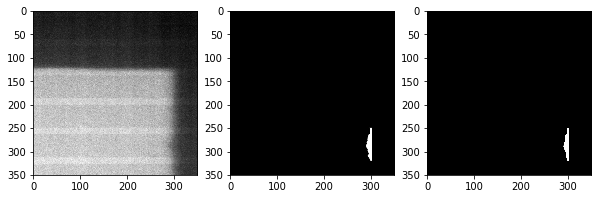

4: true_dist: 10, pred_dist: [9.776103]


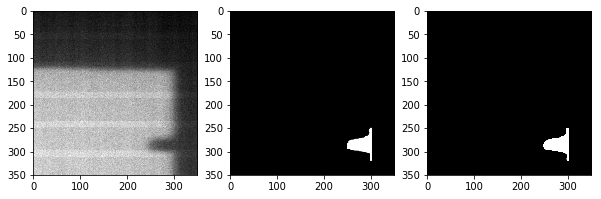

5: true_dist: 30, pred_dist: [22.345236]


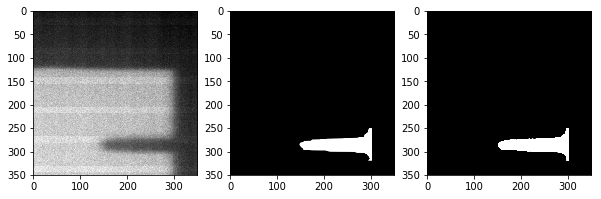

6: true_dist: 20, pred_dist: [19.606796]


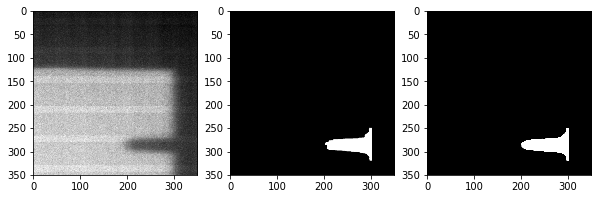

7: true_dist: 30, pred_dist: [23.444736]


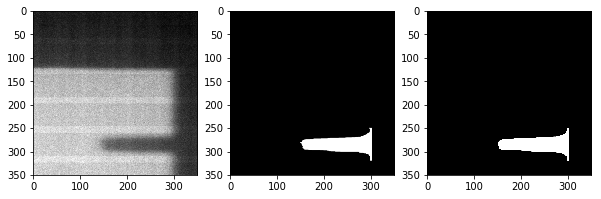

8: true_dist: 1, pred_dist: [0.98141146]


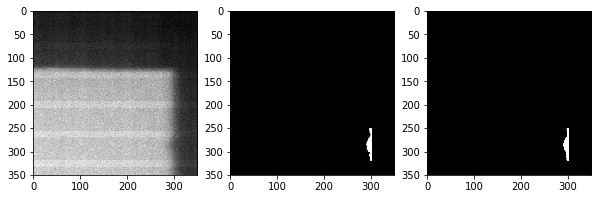

9: true_dist: 2, pred_dist: [1.7640685]


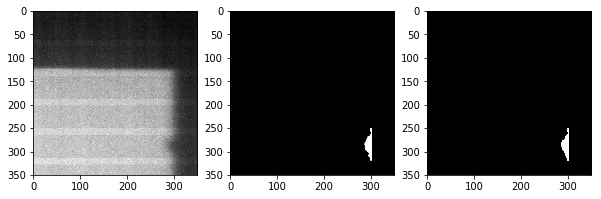

10: true_dist: 30, pred_dist: [22.869528]


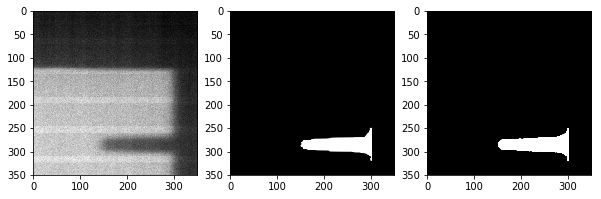

11: true_dist: 15, pred_dist: [14.911922]


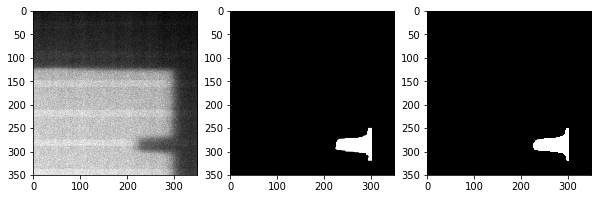

12: true_dist: 3, pred_dist: [22.301983]


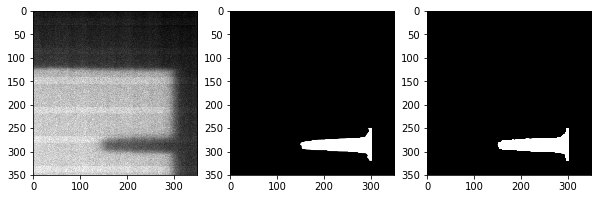

13: true_dist: 1, pred_dist: [0.80911595]


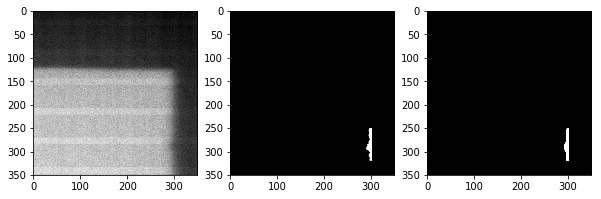

14: true_dist: 3, pred_dist: [2.8681848]


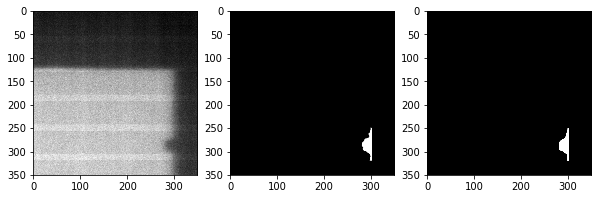

15: true_dist: 4, pred_dist: [4.0409036]


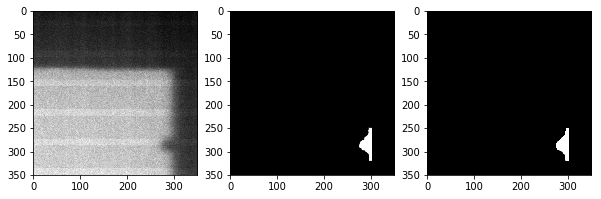

16: true_dist: 1, pred_dist: [0.9314916]


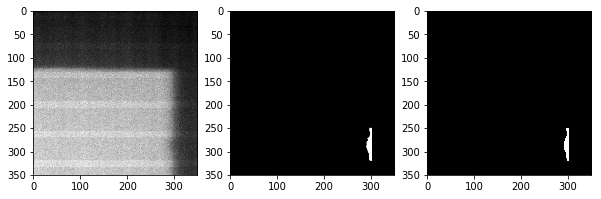

In [20]:
for i, batch in enumerate(data_loaders['test']):

    true_images, true_masks, true_dists = batch['image'], batch['mask'], batch['dist']
    pred_masks, pred_dists = model_inference(true_images.float().to(device))
    print("batch {}".format(i+1))
    for j, (img, tr_msk, tr_dist, pr_msk, pr_dist) in enumerate(zip(true_images,
                                                 true_masks, 
                                                 true_dists.cpu().detach().numpy(),
                                                 pred_masks.cpu().detach().numpy(), 
                                                 pred_dists.cpu().detach().numpy())):
    
        true_dist = tr_dist
        pred_dist = pr_dist
        print("{}: true_dist: {}, pred_dist: {}".format(j+1, true_dist, pred_dist))
        
        f = plt.figure(figsize=(10,5))
        f.add_subplot(1,3, 1)
        plt.imshow(img[0,...], cmap='gray')
        f.add_subplot(1,3, 2)
        plt.imshow(tr_msk[0,...], cmap='gray')
        f.add_subplot(1,3, 3)
        plt.imshow(pr_msk[0,...], cmap='gray')
        plt.show(block=True)
        
    if i==1:
        break

In [21]:
y_true = []
y_pred = []

for i, batch in tqdm.tqdm(enumerate(data_loaders['test'])):
    true_images, true_dists = batch['image'], batch['dist']
    _, pred_dists = model_inference(true_images.float().to(device))
#    print("batch {}".format(i + 1))
    for j, (img, tr_dist, pr_dist) in enumerate(zip(true_images,
                                                true_dists.cpu().detach().numpy(),
                                                pred_dists.cpu().detach().numpy())):
        true_dist = tr_dist
        pred_dist = pr_dist
        y_true.append(true_dist)
        y_pred.append(pred_dist)




113it [03:07,  1.32s/it]


In [22]:
y_pred = np.asarray(y_pred).ravel()
y_true = np.asarray(y_true)

print("mse: {}".format(mean_squared_error(y_true, y_pred)))

mse: 18.625912374734217


In [23]:
def get_idx(arr, key):
    return np.where(arr==key)[0]

In [24]:
def idx_mse(dist, true_arr = y_true, preds_arr = y_pred):
    idx = np.where(true_arr==dist)[0]
    mse = mean_squared_error(true_arr[idx], preds_arr[idx])
    print(dist, mse)
    return idx, mse 

In [25]:
idx_1, mse_1 = idx_mse(1)
idx_2, mse_2 = idx_mse(2)
idx_3, mse_3 = idx_mse(3)
idx_4, mse_4 = idx_mse(4)
idx_10, mse_10 = idx_mse(10)
idx_15, mse_15 = idx_mse(15)
idx_20, mse_20 = idx_mse(20)
idx_25, mse_25 = idx_mse(25)
idx_30, mse_30 = idx_mse(30)
idx_35, mse_35 = idx_mse(35)

1 0.036994536428671475
2 0.04449256693109123
3 136.97738787598078
4 0.026437142515185856
10 0.031770740874427064
15 0.03906002747623796
20 0.07106579007631808
25 0.07027757532197339
30 49.76113434091553
35 0.23344300510666835


In [26]:
distances = [1,2,3,4,10,15,20,25,30,35]

In [27]:
errors = [idx_mse(i)[1] for i in distances]

1 0.036994536428671475
2 0.04449256693109123
3 136.97738787598078
4 0.026437142515185856
10 0.031770740874427064
15 0.03906002747623796
20 0.07106579007631808
25 0.07027757532197339
30 49.76113434091553
35 0.23344300510666835


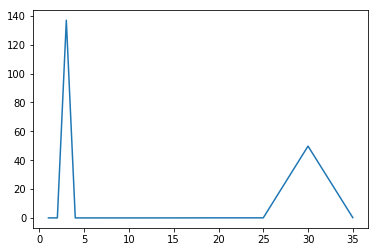

In [28]:
plt.plot(distances, errors)

#### let's round the numbers

In [29]:
y_pred_round = np.round(y_pred)

In [30]:
mean_squared_error(y_true, y_pred_round)

18.485555555555557

In [31]:
errors_round = [idx_mse(i, preds_arr=y_pred_round)[1] for i in distances]

1 0.0
2 0.00546448087431694
3 135.88571428571427
4 0.0
10 0.0
15 0.0
20 0.0
25 0.01675977653631285
30 49.55263157894737
35 0.40106951871657753


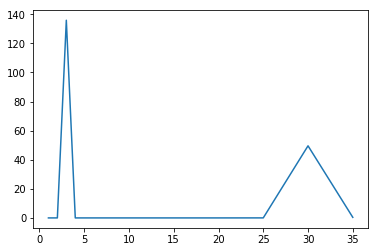

In [32]:
plt.plot(distances, errors_round)

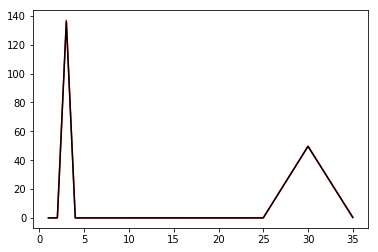

In [33]:
plt.plot(distances, errors, c='red')
plt.plot(distances, errors_round,c= 'k')

In [34]:
idx_30,mse_30 = idx_mse(30)
y_pred[idx_30]

30 49.76113434091553


array([22.191498, 22.913437, 22.722084, 22.826954, 22.861984, 22.58752 ,
       22.677868, 22.66271 , 22.410955, 24.947647, 23.32623 , 23.550129,
       23.202946, 23.393642, 22.52881 , 22.757996, 22.548565, 22.893404,
       22.755575, 23.054205, 22.453278, 23.361177, 23.886036, 23.413794,
       23.274326, 23.430267, 23.667744, 24.114855, 23.789042, 22.7977  ,
       23.832304, 23.164831, 23.37209 , 22.408989, 23.446293, 23.345734,
       23.127464, 22.678307, 23.324745, 22.96066 , 23.047428, 22.763853,
       22.584558, 22.608372, 22.522324, 23.198381, 22.920874, 23.030096,
       23.257729, 22.630884, 23.053238, 23.213444, 22.843216, 22.809868,
       22.24519 , 23.549444, 22.400505, 22.24519 , 23.04317 , 22.764288,
       23.205599, 22.338732, 22.571507, 23.114935, 22.81648 , 22.55322 ,
       22.339838, 22.880726, 23.309015, 23.205599, 22.515036, 22.82514 ,
       22.949537, 22.63455 , 22.452097, 22.766727, 24.497658, 22.764889,
       22.776546, 22.651052, 22.408989, 22.400505, 

In [35]:
idx_3,mse_3 = idx_mse(3)
y_pred[idx_3]

3 136.97738787598078


array([22.859436 ,  2.7031727,  2.930854 ,  2.92484  ,  2.8924797,
        2.842634 , 22.437849 , 23.295563 , 22.949537 ,  2.885768 ,
        2.6399882,  2.8237069,  2.9128869, 22.957586 , 22.410952 ,
        2.8551795,  2.9521215,  2.7853634,  2.9141762,  2.7417805,
        2.781065 , 22.366896 ,  2.729521 ,  2.8166485, 22.476612 ,
        2.8244421, 22.651052 ,  2.8215733, 22.763853 ,  2.7975786,
       22.301983 ,  2.7667232,  2.7536626,  2.6966703,  2.7944543,
        2.8958871, 23.478344 , 22.345236 ,  2.802717 ,  2.825494 ,
        2.8434708, 22.360287 ,  2.794419 ,  2.791922 , 22.684906 ,
       22.834703 ,  2.8035007,  3.0222907,  2.911224 ,  2.7845538,
        2.8958664, 22.60489  ,  3.0299506,  2.7074823, 23.04219  ,
        2.7576513, 22.323448 ,  2.7844725,  2.814642 ,  2.7563221,
        2.8428261,  2.7560163,  2.8255148,  2.9673   ,  2.7965293,
        2.7339876, 22.366148 ,  2.8961337,  2.835365 ,  2.8623319,
        2.7243068, 23.191046 ,  2.7781324, 22.683353 , 22.3387

In [36]:
idx_30_round,mse_30_round = idx_mse(30, preds_arr=y_pred_round)
y_pred_round[idx_30]

30 49.55263157894737


array([22., 23., 23., 23., 23., 23., 23., 23., 22., 25., 23., 24., 23.,
       23., 23., 23., 23., 23., 23., 23., 22., 23., 24., 23., 23., 23.,
       24., 24., 24., 23., 24., 23., 23., 22., 23., 23., 23., 23., 23.,
       23., 23., 23., 23., 23., 23., 23., 23., 23., 23., 23., 23., 23.,
       23., 23., 22., 24., 22., 22., 23., 23., 23., 22., 23., 23., 23.,
       23., 22., 23., 23., 23., 23., 23., 23., 23., 22., 23., 24., 23.,
       23., 23., 22., 22., 23., 23., 23., 23., 23., 23., 23., 22., 23.,
       23., 23., 23., 24., 23., 22., 23., 24., 23., 23., 23., 24., 23.,
       23., 23., 23., 24., 24., 25., 22., 23., 23., 25., 23., 22., 24.,
       23., 23., 22., 23., 24., 23., 23., 23., 23., 23., 23., 23., 23.,
       22., 23., 23., 23., 22., 23., 23., 23., 23., 23., 22., 22., 23.,
       22., 22., 23., 23., 23., 23., 23., 23., 23., 22., 23., 23., 23.,
       23., 24., 23., 23., 23., 23., 24., 23., 23., 24., 23., 23., 23.,
       23., 23., 23., 22., 23., 22., 22., 22., 23., 23., 22., 24

In [37]:
idx_3_round,mse_3_round = idx_mse(3, preds_arr=y_pred_round)
y_pred_round[idx_3]

3 135.88571428571427


array([23.,  3.,  3.,  3.,  3.,  3., 22., 23., 23.,  3.,  3.,  3.,  3.,
       23., 22.,  3.,  3.,  3.,  3.,  3.,  3., 22.,  3.,  3., 22.,  3.,
       23.,  3., 23.,  3., 22.,  3.,  3.,  3.,  3.,  3., 23., 22.,  3.,
        3.,  3., 22.,  3.,  3., 23., 23.,  3.,  3.,  3.,  3.,  3., 23.,
        3.,  3., 23.,  3., 22.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,  3.,
        3., 22.,  3.,  3.,  3.,  3., 23.,  3., 23., 22.,  3.,  3., 24.,
       23.,  3., 23.,  3.,  3.,  3., 23., 23.,  3.,  3.,  3.,  3.,  3.,
       23., 23., 22., 23., 23.,  3.,  3., 23.,  3.,  3.,  3.,  3.,  3.,
        3.,  3., 23.,  3.,  3.,  3.,  3.,  3., 23.,  3., 23.,  3.,  3.,
        3.,  3.,  3.,  3.,  3., 22., 23., 23.,  3.,  3.,  3.,  3., 23.,
       23.,  3.,  3., 23.,  3., 22.,  3.,  3., 22.,  3.,  3.,  3., 23.,
       23.,  3.,  3., 23.,  3., 23., 24., 22.,  3.,  3.,  3.,  3., 22.,
       23., 22.,  3.,  3., 23., 23.,  3., 22.,  3.,  3.,  3., 23.,  3.,
       23.,  3., 23.,  3.,  3., 23.], dtype=float32)

### something's wrong. Let's look at the data

In [20]:
y_true = []
y_pred = []
X_true = []
for i, batch in tqdm.tqdm(enumerate(data_loaders['test'])):
    true_images, true_dists = batch['image'], batch['dist']
    _, pred_dists = model_inference(true_images.float().to(device))
#    print("batch {}".format(i + 1))
    for j, (img, tr_dist, pr_dist) in enumerate(zip(true_images.cpu().detach().numpy(),
                                                true_dists.cpu().detach().numpy(),
                                                pred_dists.cpu().detach().numpy())):
        true_image = img
        true_dist = tr_dist
        pred_dist = pr_dist
        y_true.append(true_dist)
        y_pred.append(pred_dist)
        X_true.append(true_image)

112it [01:59,  1.00s/it]


In [21]:
y_pred = np.asarray(y_pred).ravel()
y_true = np.asarray(y_true)
x_true = np.asarray(X_true)

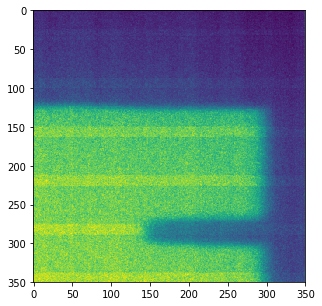

true dist: 30, pred dist: 22.925254821777344


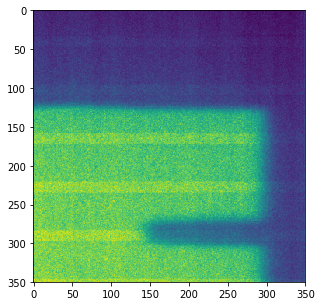

true dist: 30, pred dist: 23.19731903076172


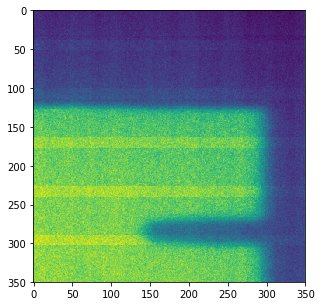

true dist: 30, pred dist: 24.433149337768555


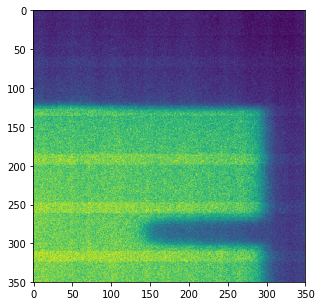

true dist: 30, pred dist: 24.334117889404297


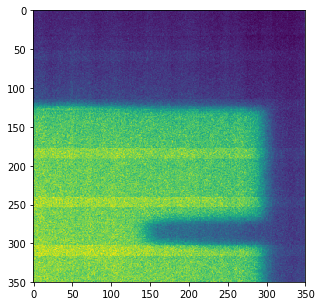

true dist: 30, pred dist: 24.62344741821289


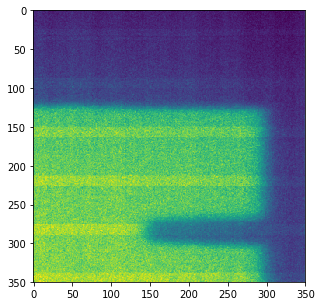

true dist: 30, pred dist: 22.9460391998291


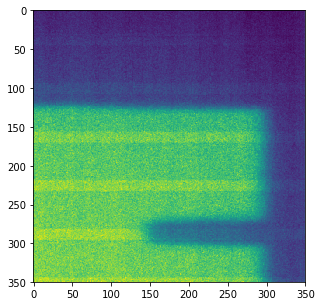

true dist: 30, pred dist: 22.42115020751953


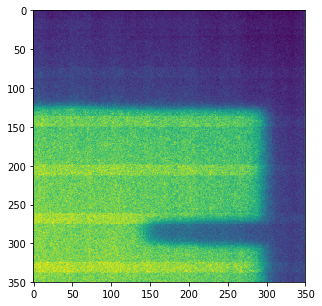

true dist: 30, pred dist: 24.368789672851562


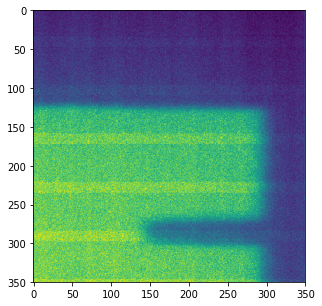

true dist: 30, pred dist: 23.66146469116211


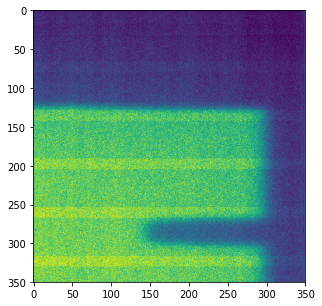

true dist: 30, pred dist: 23.894908905029297


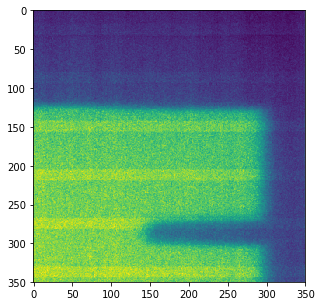

true dist: 30, pred dist: 22.772281646728516


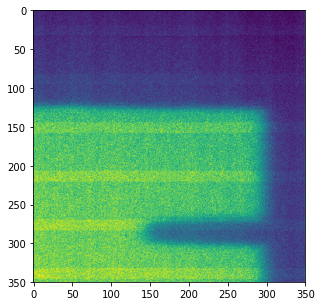

true dist: 30, pred dist: 23.318204879760742


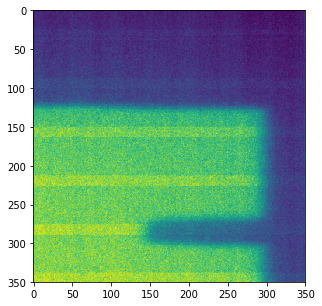

true dist: 30, pred dist: 22.975757598876953


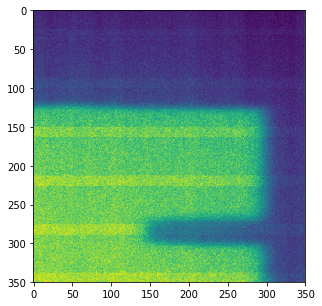

true dist: 30, pred dist: 22.992717742919922


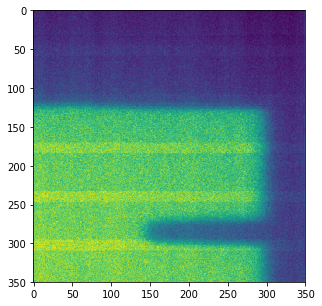

true dist: 30, pred dist: 24.59135627746582


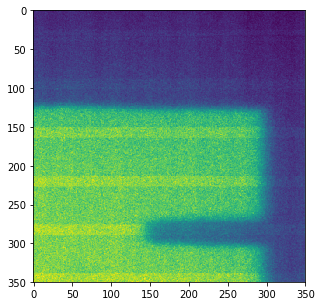

true dist: 30, pred dist: 23.35945701599121


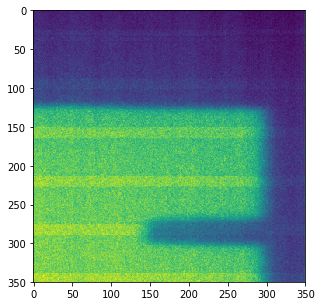

true dist: 30, pred dist: 22.563613891601562


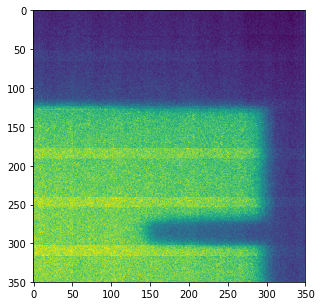

true dist: 30, pred dist: 23.745725631713867


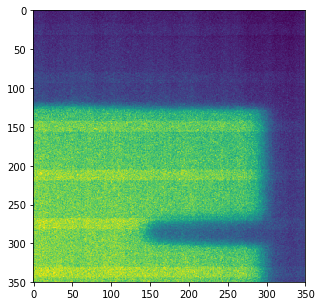

true dist: 30, pred dist: 22.903493881225586


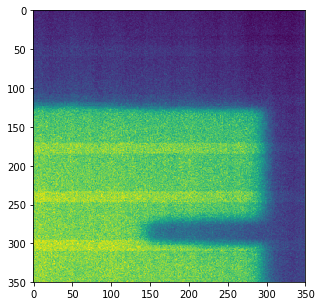

true dist: 30, pred dist: 24.92821502685547


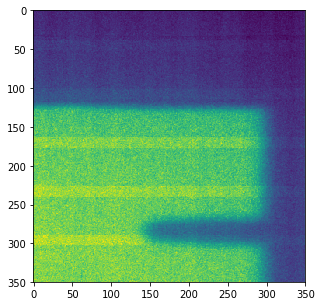

true dist: 30, pred dist: 24.164457321166992


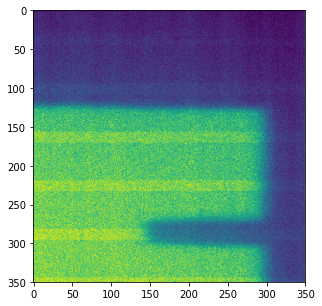

true dist: 30, pred dist: 22.369047164916992


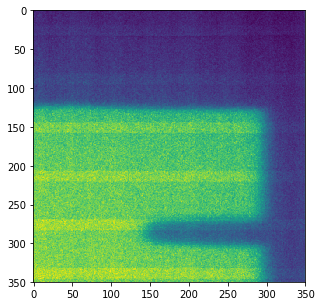

true dist: 30, pred dist: 23.591794967651367


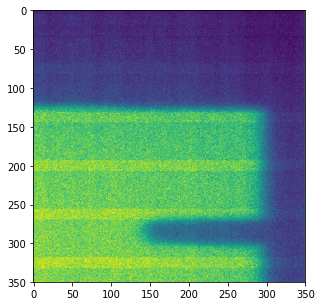

true dist: 30, pred dist: 24.786006927490234


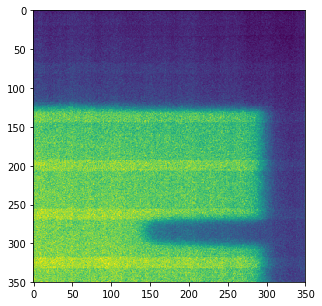

true dist: 30, pred dist: 24.491390228271484


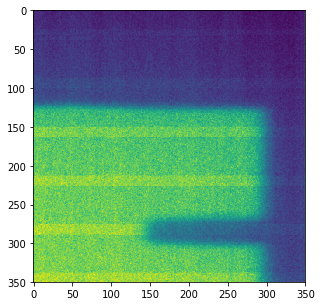

true dist: 30, pred dist: 22.469722747802734


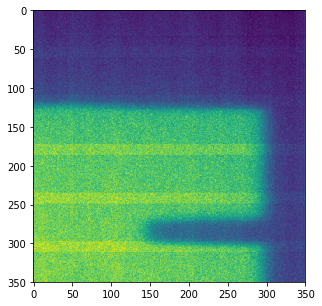

true dist: 30, pred dist: 24.33856773376465


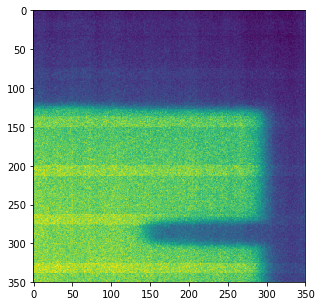

true dist: 30, pred dist: 24.633060455322266


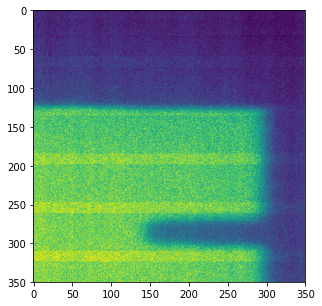

true dist: 30, pred dist: 23.729013442993164


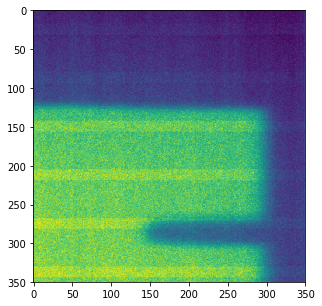

true dist: 30, pred dist: 22.86948013305664


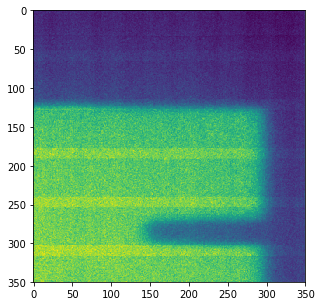

true dist: 30, pred dist: 24.137975692749023


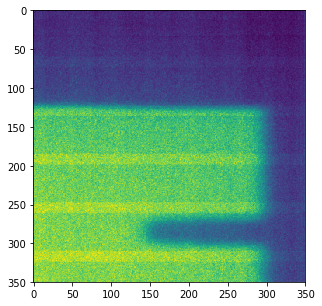

true dist: 30, pred dist: 23.75422477722168


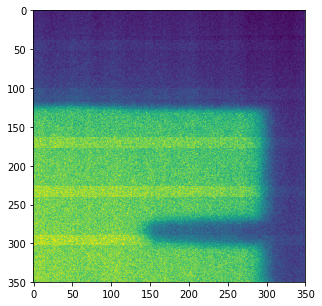

true dist: 30, pred dist: 23.371171951293945


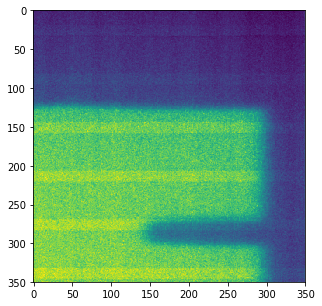

true dist: 30, pred dist: 23.111331939697266


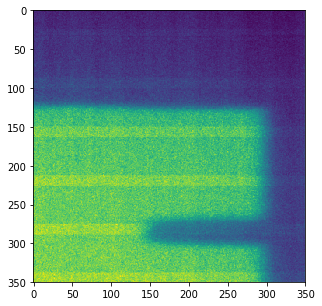

true dist: 30, pred dist: 22.540536880493164


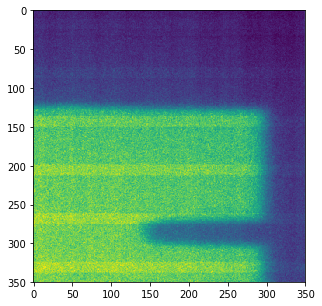

true dist: 30, pred dist: 24.304183959960938


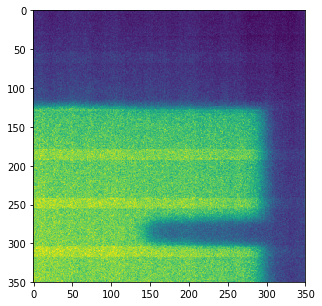

true dist: 30, pred dist: 23.985321044921875


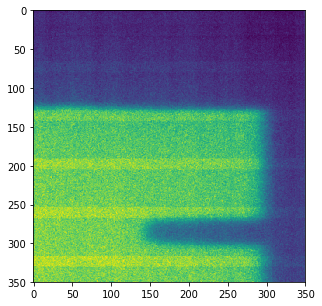

true dist: 30, pred dist: 24.06122398376465


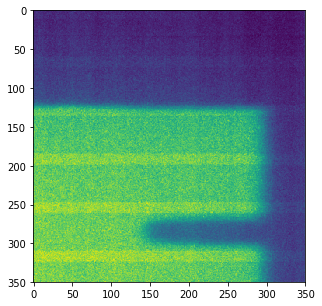

true dist: 30, pred dist: 24.376358032226562


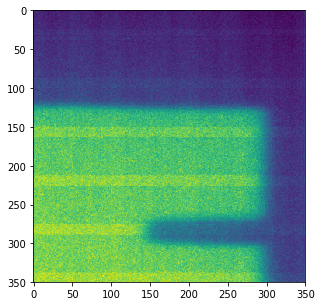

true dist: 30, pred dist: 22.397357940673828


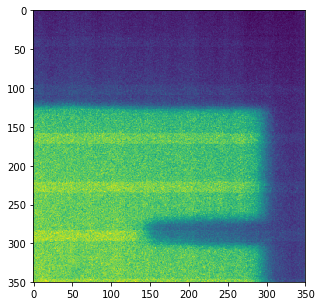

true dist: 30, pred dist: 22.571455001831055


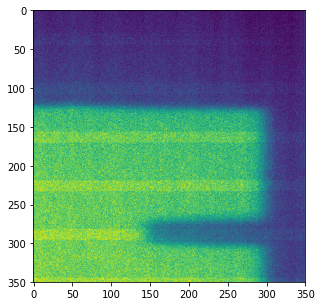

true dist: 30, pred dist: 22.695837020874023


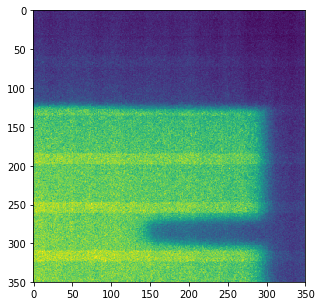

true dist: 30, pred dist: 23.649368286132812


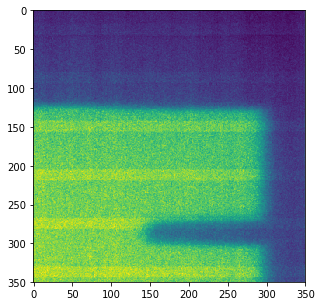

true dist: 30, pred dist: 22.772281646728516


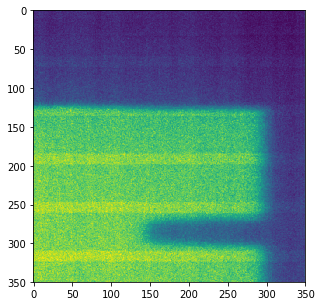

true dist: 30, pred dist: 23.837688446044922


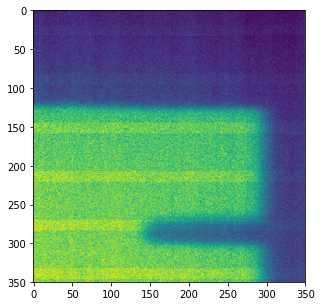

true dist: 30, pred dist: 24.1727352142334


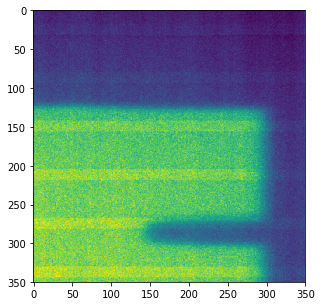

true dist: 30, pred dist: 22.912132263183594


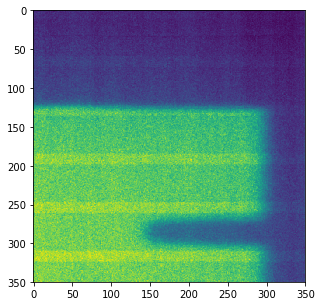

true dist: 30, pred dist: 23.641328811645508


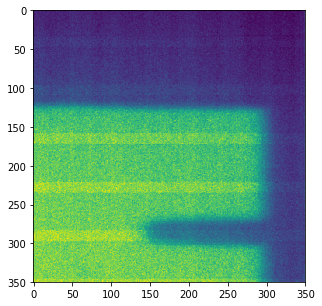

true dist: 30, pred dist: 22.718048095703125


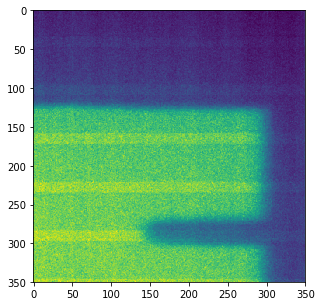

true dist: 30, pred dist: 23.116880416870117


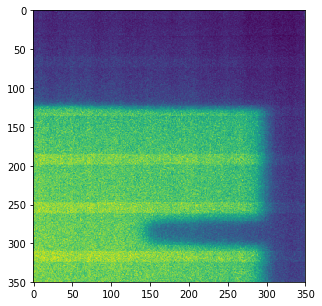

true dist: 30, pred dist: 24.166032791137695


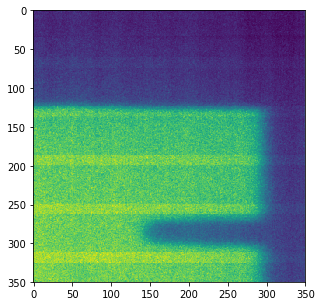

true dist: 30, pred dist: 25.146350860595703


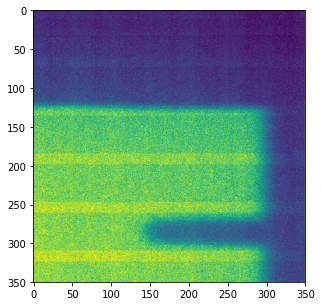

true dist: 30, pred dist: 23.594436645507812


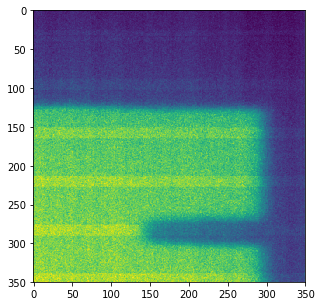

true dist: 30, pred dist: 24.09590721130371


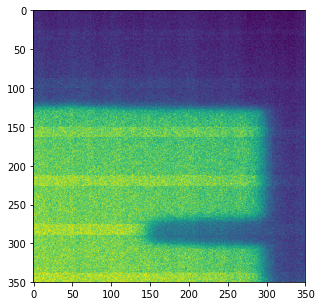

true dist: 30, pred dist: 22.32172966003418


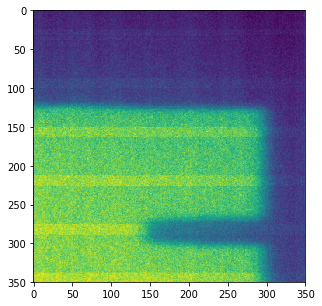

true dist: 30, pred dist: 22.685914993286133


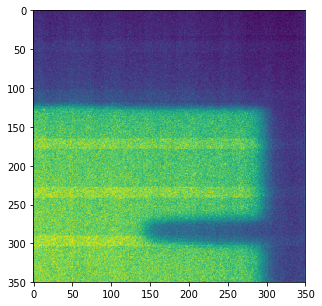

true dist: 30, pred dist: 24.61254119873047


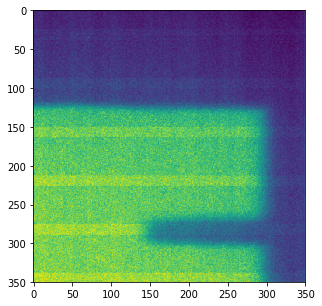

true dist: 30, pred dist: 22.546600341796875


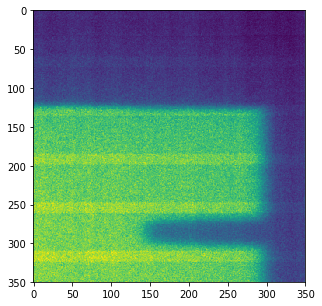

true dist: 30, pred dist: 24.373558044433594


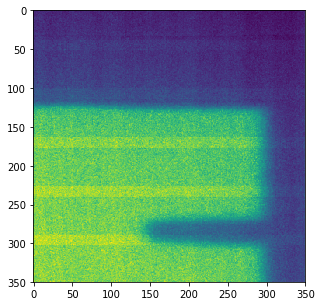

true dist: 30, pred dist: 23.05320167541504


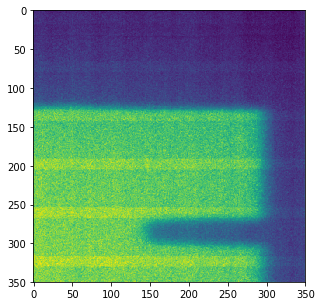

true dist: 30, pred dist: 24.077152252197266


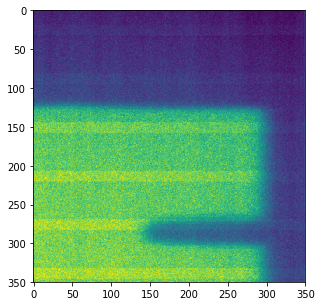

true dist: 30, pred dist: 23.674217224121094


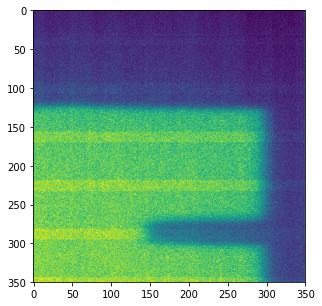

true dist: 30, pred dist: 22.221208572387695


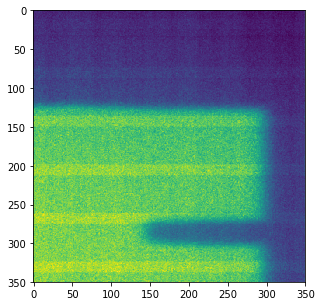

true dist: 30, pred dist: 24.007875442504883


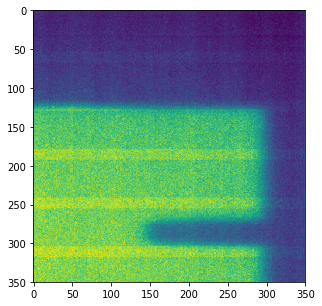

true dist: 30, pred dist: 24.096776962280273


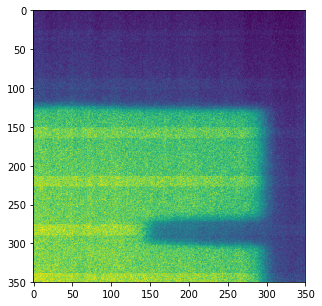

true dist: 30, pred dist: 23.00746726989746


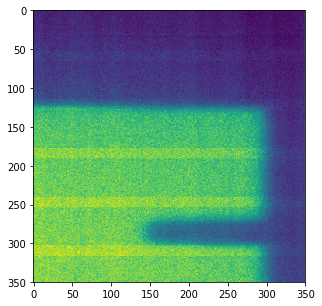

true dist: 30, pred dist: 24.20552635192871


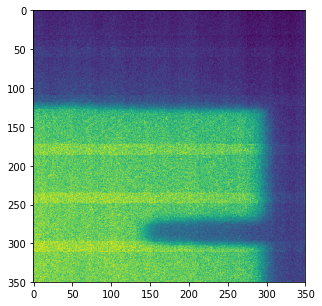

true dist: 30, pred dist: 24.549617767333984


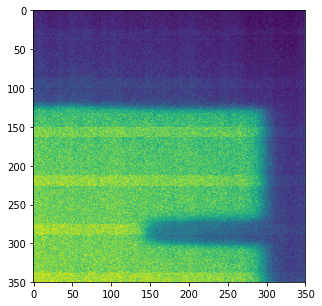

true dist: 30, pred dist: 23.13375473022461


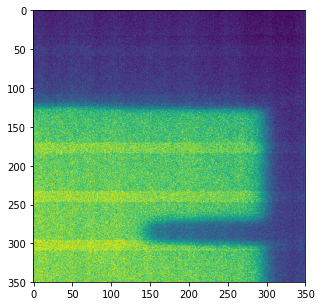

true dist: 30, pred dist: 24.740047454833984


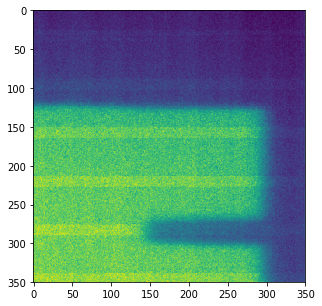

true dist: 30, pred dist: 22.79362678527832


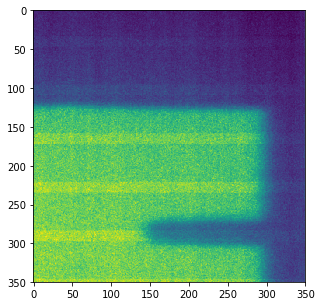

true dist: 30, pred dist: 23.360822677612305


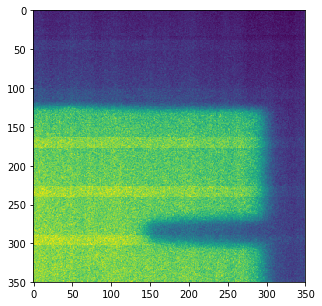

true dist: 30, pred dist: 23.5585994720459


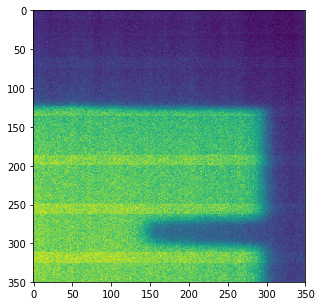

true dist: 30, pred dist: 24.40779685974121


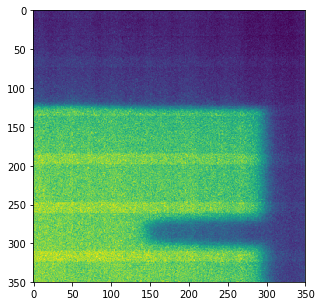

true dist: 30, pred dist: 23.998872756958008


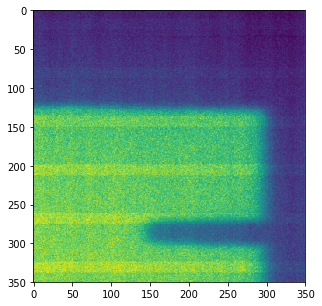

true dist: 30, pred dist: 23.796552658081055


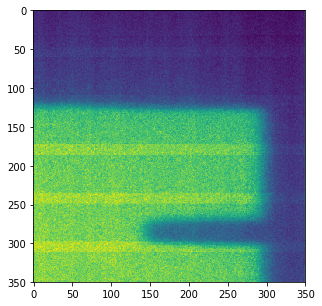

true dist: 30, pred dist: 25.181987762451172


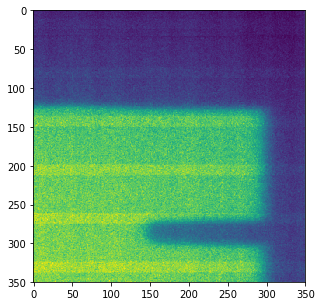

true dist: 30, pred dist: 23.4505615234375


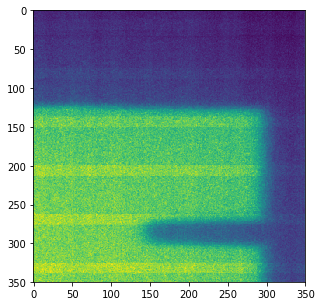

true dist: 30, pred dist: 24.53860855102539


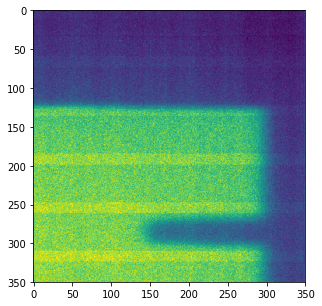

true dist: 30, pred dist: 23.44015884399414


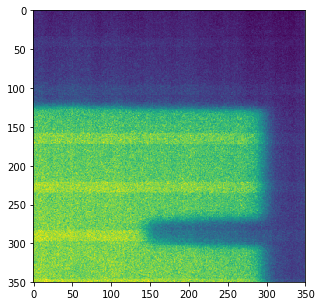

true dist: 30, pred dist: 22.88812255859375


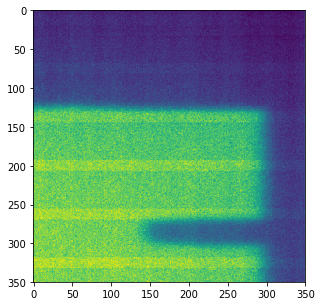

true dist: 30, pred dist: 24.44449806213379


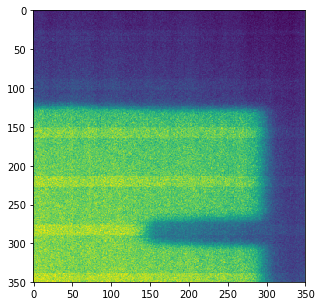

true dist: 30, pred dist: 22.95659637451172


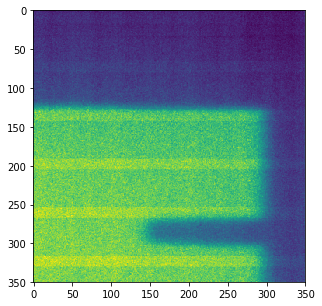

true dist: 30, pred dist: 23.380197525024414


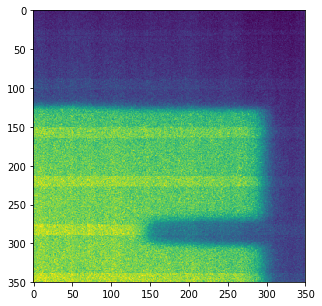

true dist: 30, pred dist: 22.91305923461914


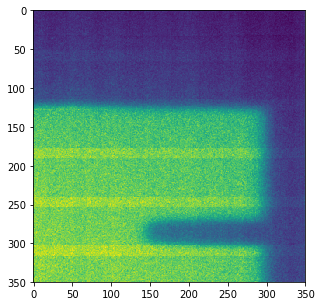

true dist: 30, pred dist: 24.09111976623535


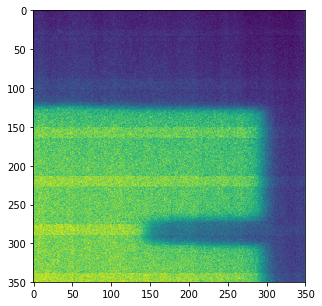

true dist: 30, pred dist: 23.140108108520508


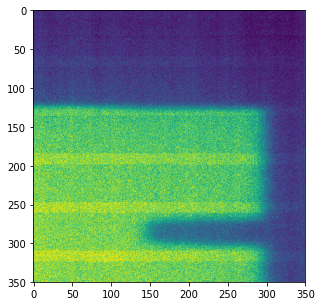

true dist: 30, pred dist: 23.836101531982422


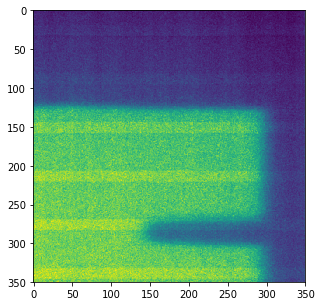

true dist: 30, pred dist: 23.15909767150879


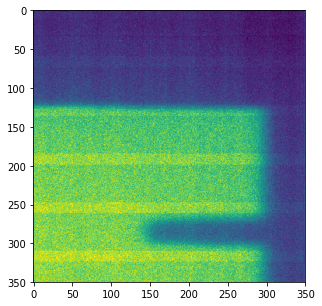

true dist: 30, pred dist: 23.44015884399414


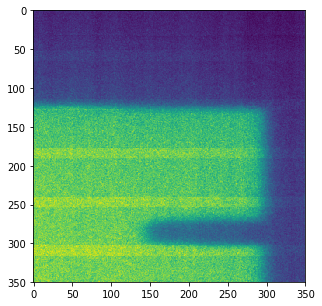

true dist: 30, pred dist: 24.142131805419922


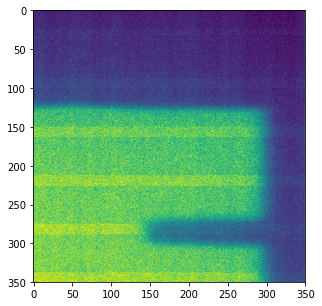

true dist: 30, pred dist: 22.920528411865234


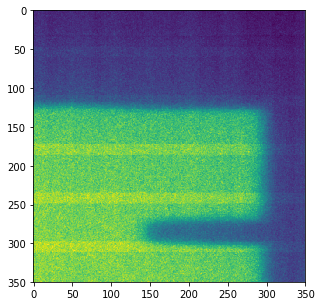

true dist: 30, pred dist: 24.679170608520508


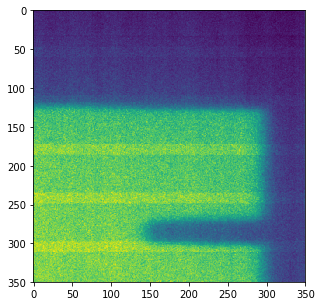

true dist: 30, pred dist: 24.947834014892578


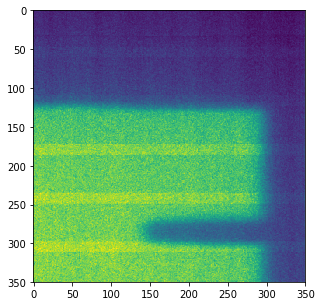

true dist: 30, pred dist: 25.284976959228516


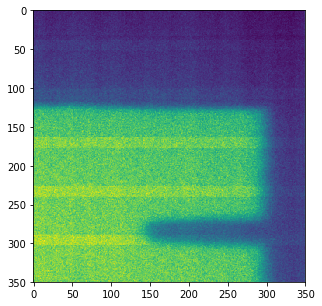

true dist: 30, pred dist: 23.645641326904297


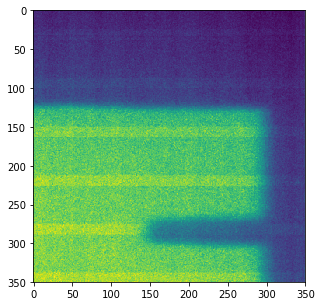

true dist: 30, pred dist: 22.40935707092285


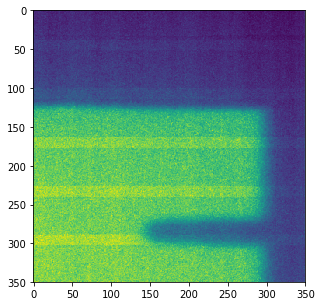

true dist: 30, pred dist: 23.718246459960938


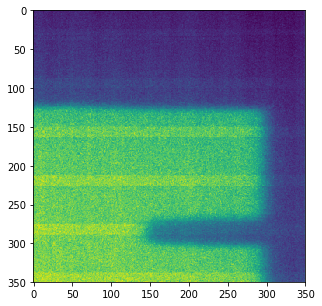

true dist: 30, pred dist: 22.694110870361328


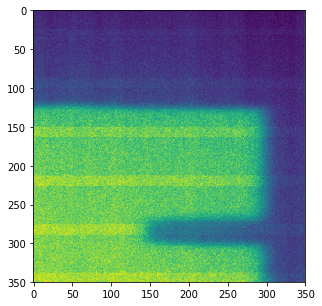

true dist: 30, pred dist: 22.992717742919922


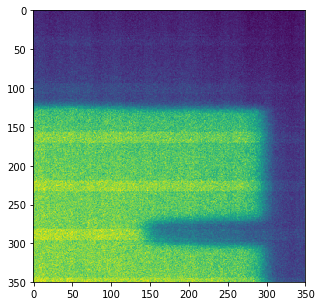

true dist: 30, pred dist: 22.636213302612305


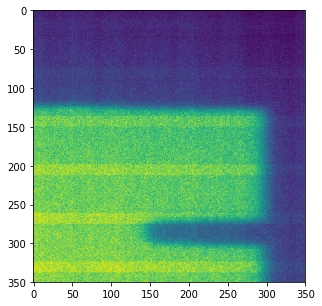

true dist: 30, pred dist: 23.62392807006836


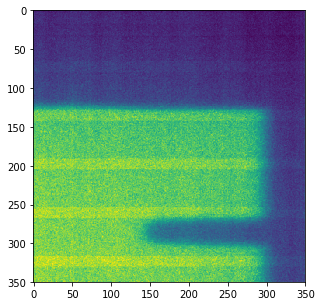

true dist: 30, pred dist: 23.93992042541504


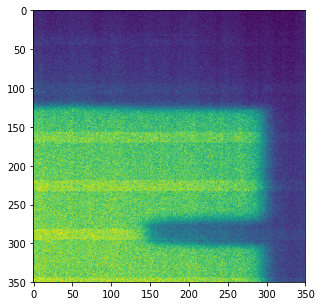

true dist: 30, pred dist: 22.36456298828125


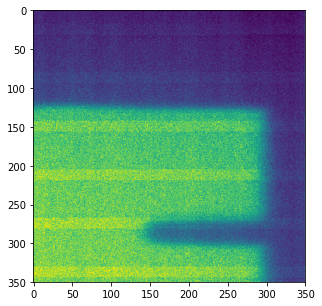

true dist: 30, pred dist: 23.125682830810547


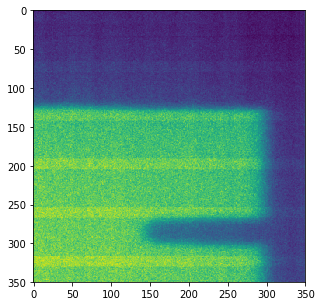

true dist: 30, pred dist: 23.831111907958984


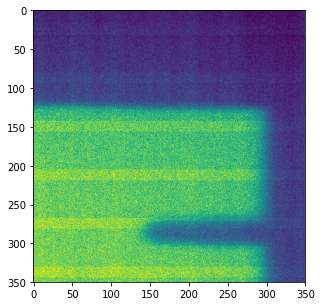

true dist: 30, pred dist: 23.161800384521484


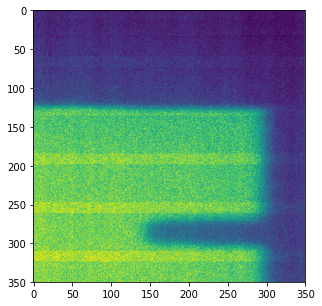

true dist: 30, pred dist: 23.729013442993164


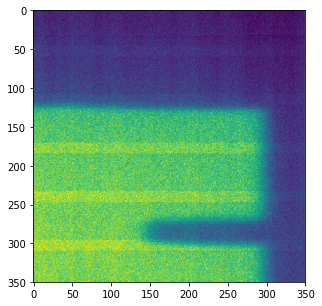

true dist: 30, pred dist: 24.385746002197266


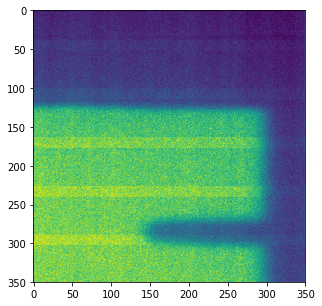

true dist: 30, pred dist: 23.607074737548828


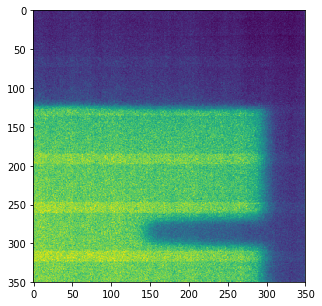

true dist: 30, pred dist: 24.108280181884766


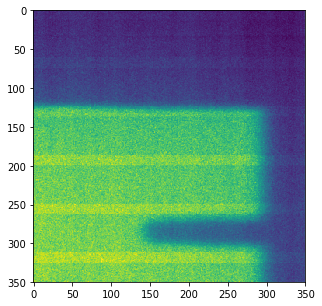

true dist: 30, pred dist: 25.02126121520996


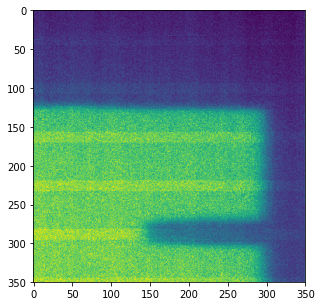

true dist: 30, pred dist: 22.744970321655273


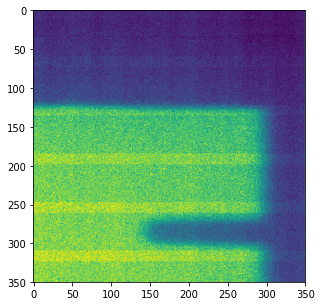

true dist: 30, pred dist: 24.011857986450195


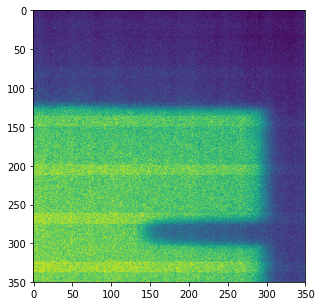

true dist: 30, pred dist: 24.004043579101562


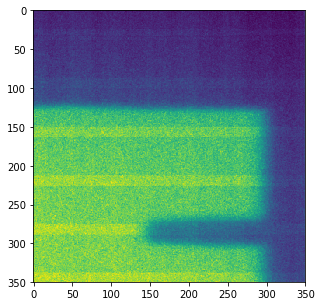

true dist: 30, pred dist: 22.543458938598633


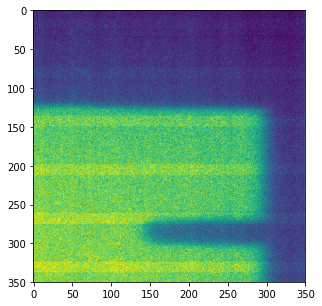

true dist: 30, pred dist: 24.07333755493164


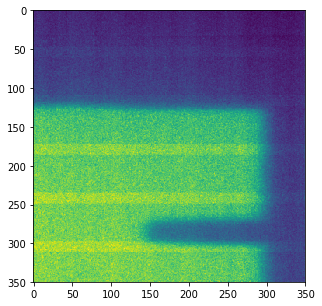

true dist: 30, pred dist: 24.577547073364258


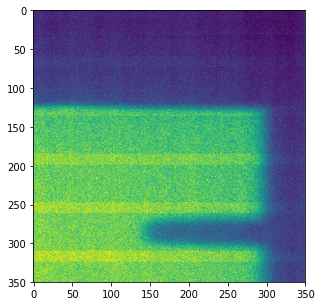

true dist: 30, pred dist: 23.977054595947266


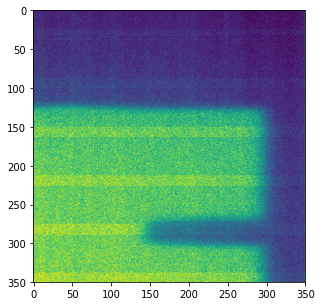

true dist: 30, pred dist: 22.64345359802246


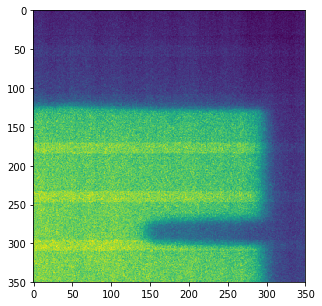

true dist: 30, pred dist: 24.643293380737305


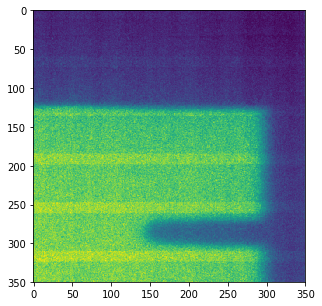

true dist: 30, pred dist: 24.312549591064453


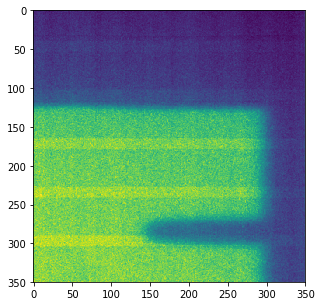

true dist: 30, pred dist: 24.568445205688477


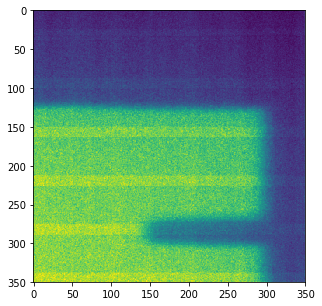

true dist: 30, pred dist: 22.937667846679688


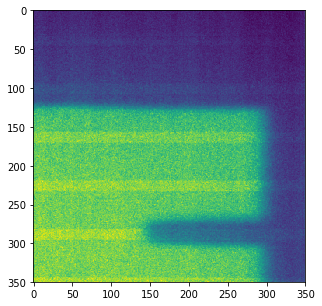

true dist: 30, pred dist: 22.640636444091797


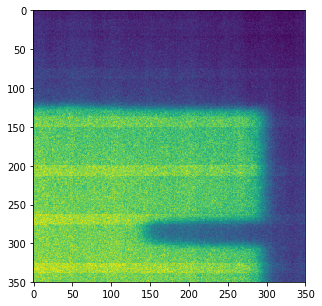

true dist: 30, pred dist: 24.63817596435547


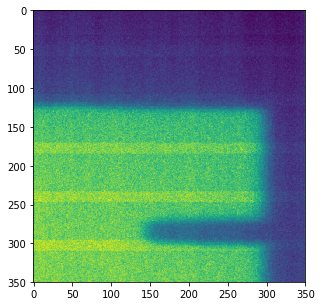

true dist: 30, pred dist: 24.59952735900879


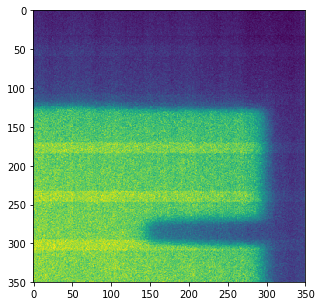

true dist: 30, pred dist: 23.936614990234375


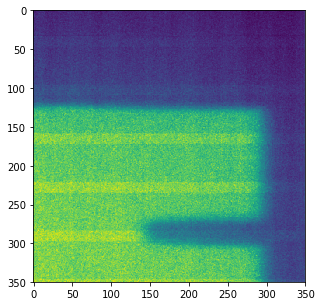

true dist: 30, pred dist: 23.605297088623047


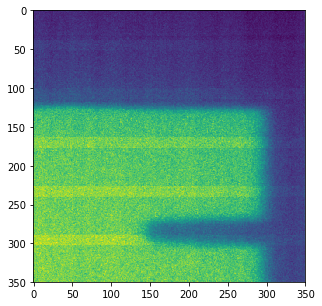

true dist: 30, pred dist: 22.943330764770508


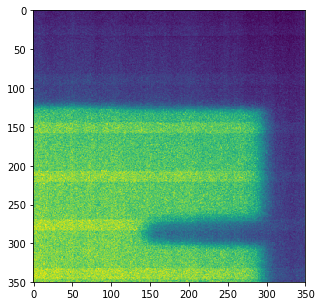

true dist: 30, pred dist: 23.83498191833496


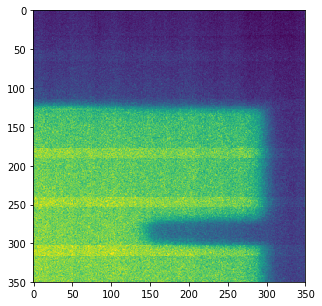

true dist: 30, pred dist: 23.971532821655273


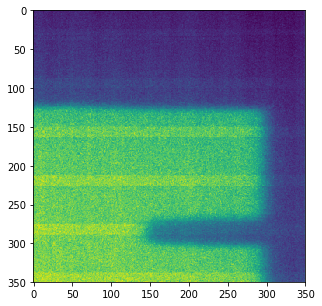

true dist: 30, pred dist: 22.694110870361328


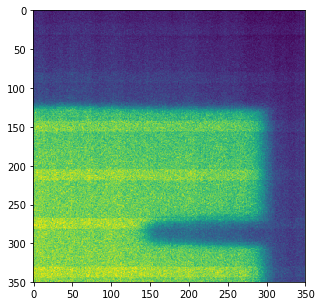

true dist: 30, pred dist: 22.755029678344727


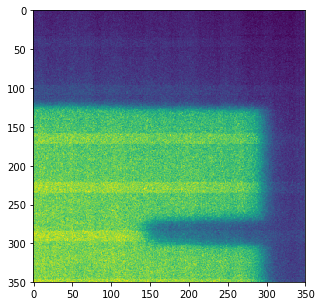

true dist: 30, pred dist: 23.8876895904541


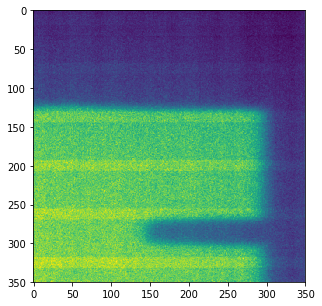

true dist: 30, pred dist: 24.312162399291992


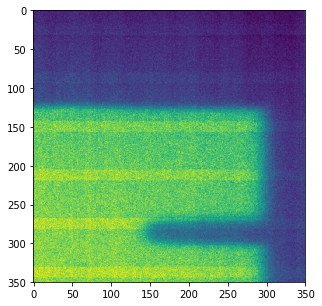

true dist: 30, pred dist: 23.077665328979492


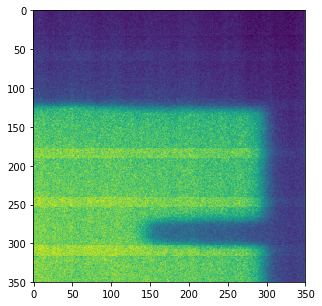

true dist: 30, pred dist: 24.41525650024414


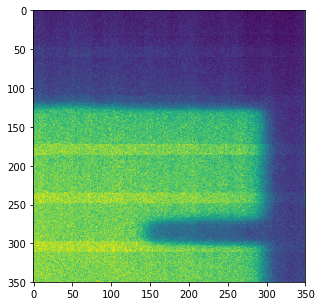

true dist: 30, pred dist: 24.825145721435547


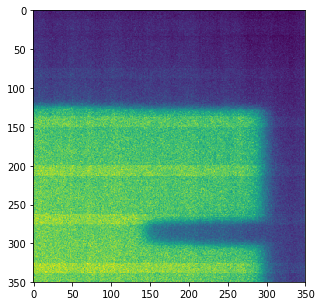

true dist: 30, pred dist: 24.302106857299805


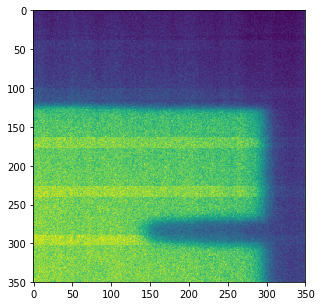

true dist: 30, pred dist: 23.385507583618164


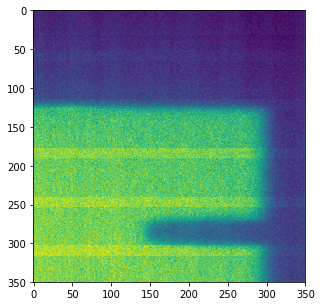

true dist: 30, pred dist: 23.83049964904785


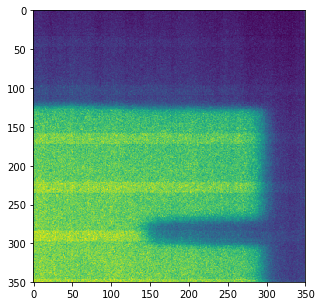

true dist: 30, pred dist: 22.745206832885742


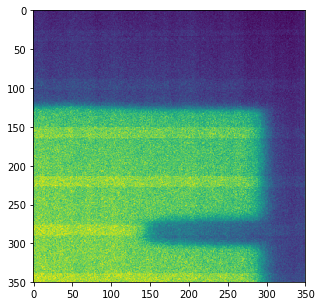

true dist: 30, pred dist: 23.78166961669922


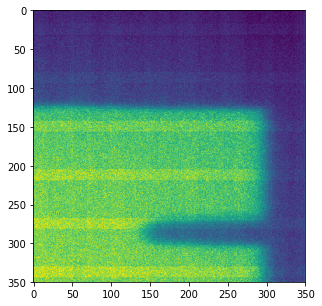

true dist: 30, pred dist: 23.189842224121094


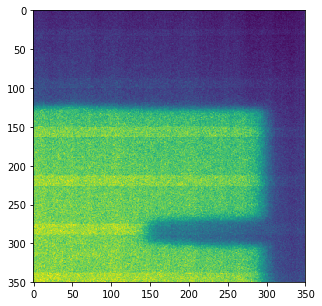

true dist: 30, pred dist: 22.740163803100586


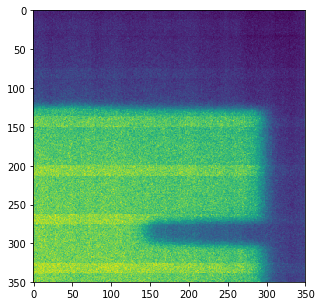

true dist: 30, pred dist: 24.496639251708984


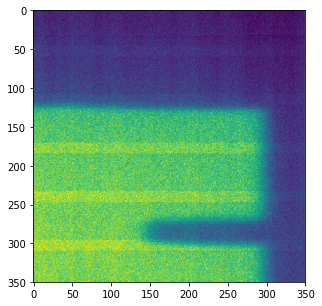

true dist: 30, pred dist: 24.385746002197266


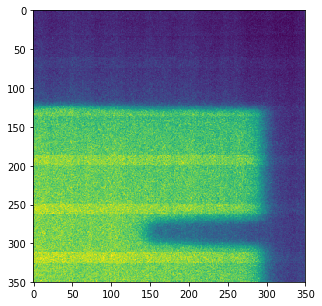

true dist: 30, pred dist: 24.316038131713867


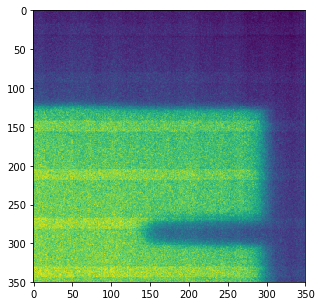

true dist: 30, pred dist: 22.981977462768555


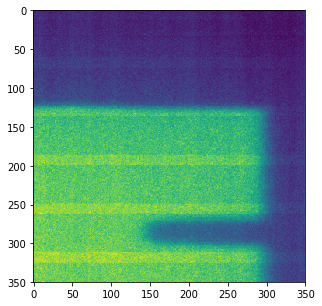

true dist: 30, pred dist: 24.089200973510742


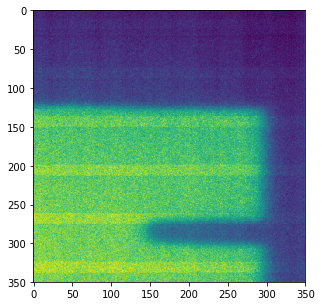

true dist: 30, pred dist: 23.55337905883789


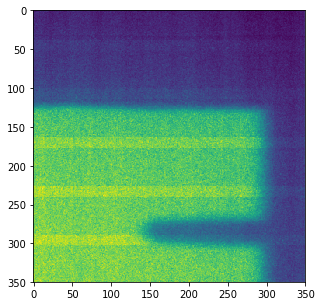

true dist: 30, pred dist: 24.198610305786133


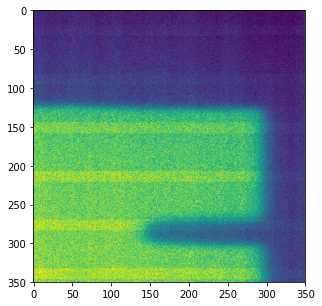

true dist: 30, pred dist: 23.62323760986328


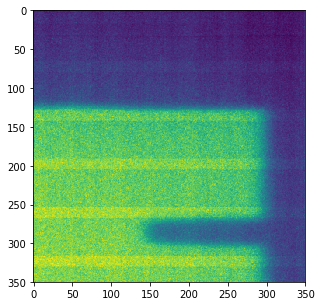

true dist: 30, pred dist: 23.814882278442383


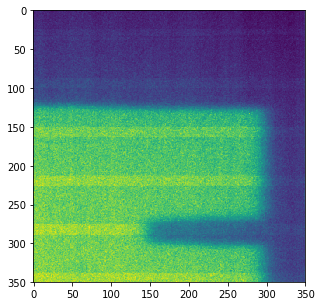

true dist: 30, pred dist: 22.763446807861328


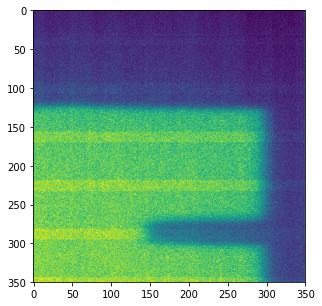

true dist: 30, pred dist: 22.221208572387695


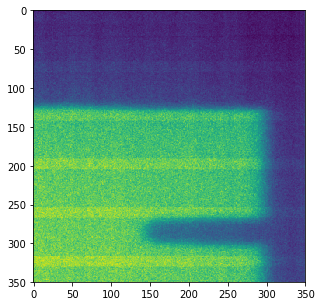

true dist: 30, pred dist: 23.831111907958984


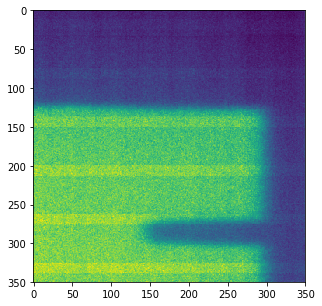

true dist: 30, pred dist: 23.932512283325195


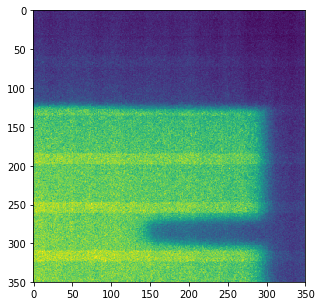

true dist: 30, pred dist: 23.649368286132812


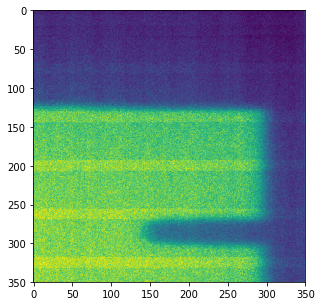

true dist: 30, pred dist: 24.6190242767334


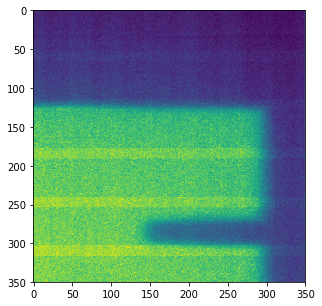

true dist: 30, pred dist: 24.50927734375


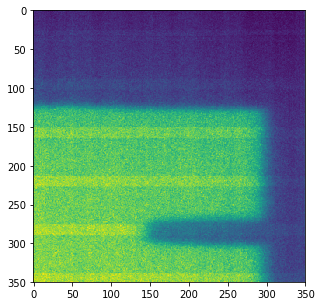

true dist: 30, pred dist: 22.719186782836914


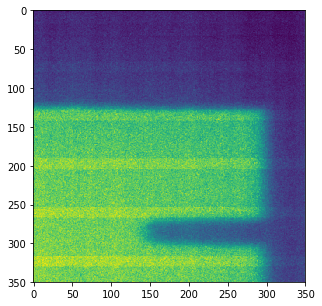

true dist: 30, pred dist: 23.77951431274414


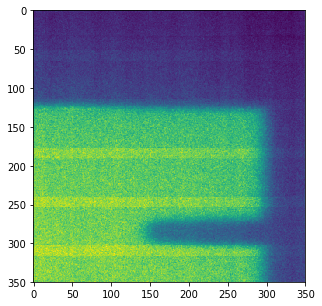

true dist: 30, pred dist: 23.831111907958984


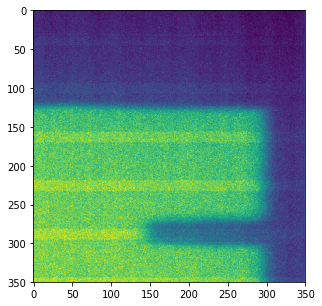

true dist: 30, pred dist: 22.298599243164062


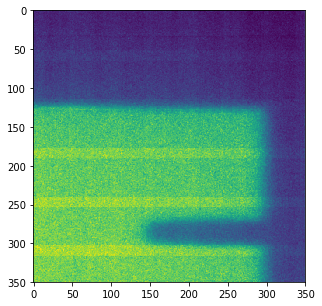

true dist: 30, pred dist: 24.361478805541992


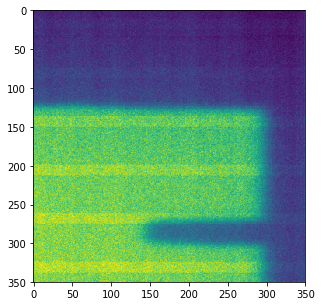

true dist: 30, pred dist: 24.130624771118164


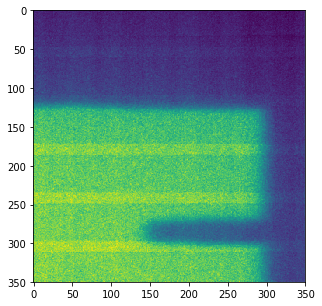

true dist: 30, pred dist: 24.944307327270508


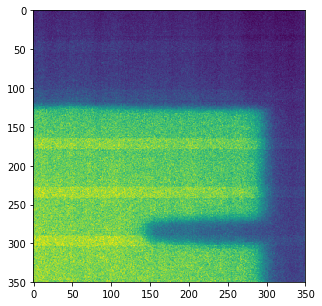

true dist: 30, pred dist: 24.697731018066406


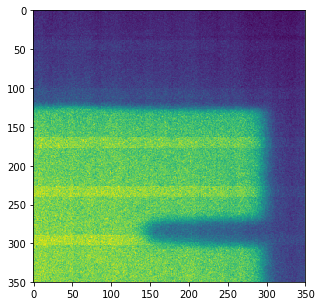

true dist: 30, pred dist: 23.795778274536133


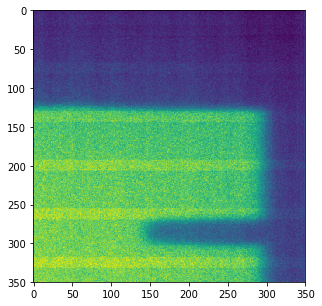

true dist: 30, pred dist: 24.067522048950195


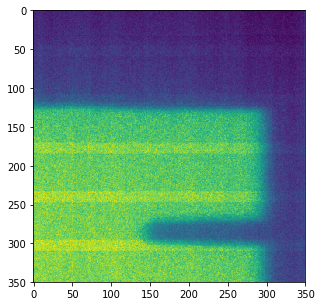

true dist: 30, pred dist: 24.661989212036133


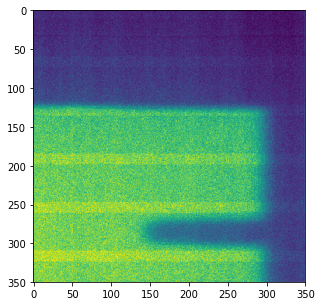

true dist: 30, pred dist: 24.41435432434082


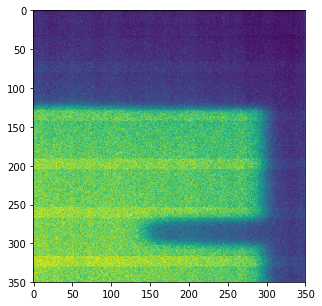

true dist: 30, pred dist: 24.127517700195312


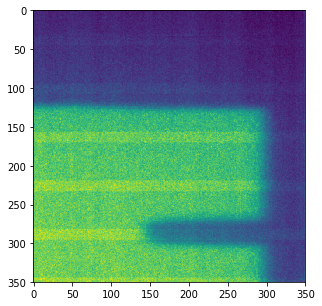

true dist: 30, pred dist: 22.646142959594727


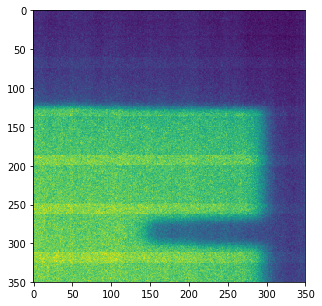

true dist: 30, pred dist: 23.809490203857422


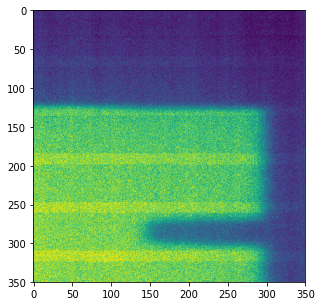

true dist: 30, pred dist: 23.836101531982422


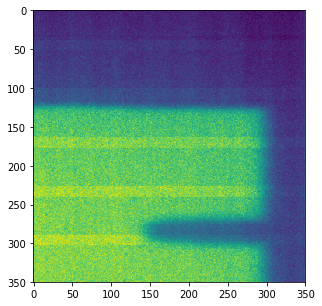

true dist: 30, pred dist: 23.36552619934082


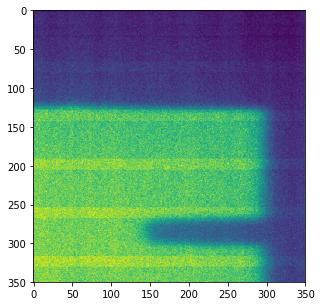

true dist: 30, pred dist: 23.71434783935547


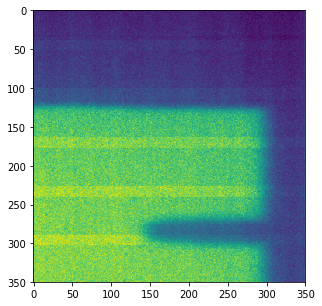

true dist: 30, pred dist: 23.36552619934082


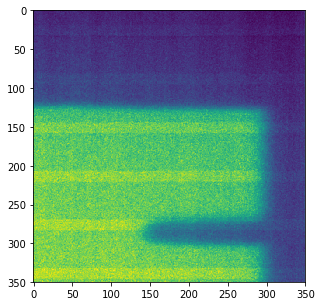

true dist: 30, pred dist: 23.782821655273438


In [25]:
for i, (img, tr_dist, pr_dist) in enumerate(zip(x_true, y_true,y_pred)):
    if(np.abs(tr_dist-pr_dist>=1)):
        plt.figure(figsize=(5,5))
        plt.imshow(img[0,...])
        plt.show()
        print("true dist: {}, pred dist: {}".format(tr_dist, pr_dist))